In [1]:
import sys
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from functions import *
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.cbook as cbook
import os, csv, requests
import math

In [2]:
load_ext autoreload

In [3]:
autoreload 2

In [4]:
## data source
data_url = 'https://opendata.ecdc.europa.eu/covid19/casedistribution/csv'

In [5]:
filename = 'covid19.csv'

In [6]:
open(filename, 'wb').write(requests.get(data_url).content)

1319602

In [7]:
df_all = pd.read_csv(filename)  

In [8]:
category = 'cases' ## we only studied the time series of cases

In [9]:
## list of countries with no less than 10,000 cumulative cases by Apr. 30
candidates_country = ['Austria'
                      , 'Belarus', 'Belgium', 'Brazil', 
                      'Canada', 'Chile', 'China', 'Ecuador', 'France', 'Germany', 
                      'India', 'Indonesia', 'Iran', 'Ireland', 'Israel', 'Italy', 'Japan', 
                      'Mexico', 'Netherlands', 
                      'Pakistan', 'Peru', 'Poland', 'Portugal',
                      'Qatar', 'Romania', 'Russia', 'Saudi_Arabia', 
                      'Singapore', 'South_Korea', 'Spain', 'Sweden', 
                      'Switzerland', 'Turkey', 'Ukraine', 'United_Arab_Emirates',
                      'United_Kingdom', 'United_States_of_America']

In [10]:
df_candidates = pd.DataFrame(columns=['country', 'date', 'cases'])
for index, row in df_all.iterrows():
    if row['countriesAndTerritories'] in candidates_country:
        date = datetime(row['year'], row['month'], row['day'])
        df_candidates = df_candidates.append({'country': row['countriesAndTerritories'], 'date': date, 
                                             'cases': row['cases']},
                                             ignore_index=True)

## Learn delta from the initial event for the 1st and the 2nd D-MDL

In [40]:
#We calcuated the delta using the inital event in Japan and applied it to all the other countries
#The initial warning for Japan was set on Feb. 27 2020 when the government required closing elementary, junior high, and high schools
#We were concerned several days before the date of the initial event since there may exist delays in announcing the event

t = np.arange(datetime(2020, 2, 17), datetime(2020, 2, 28), timedelta(days=1))

In [41]:
## daily new cases
case_values = []
for date_tmp in t:
        row = df_candidates.loc[(df_candidates['country'] == 'Japan') & (df_candidates['date'] == date_tmp)]
        if  len(row[category].values) > 0 and (row[category].values[0] > 0):
            case_values.append(row[category].values[0])
        else:
            case_values.append(0)

In [42]:
case_values

[7, 0, 7, 18, 9, 12, 27, 12, 0, 20, 22]

In [43]:
## Calculating the delta for the 1st D-MDL
for i in range(5,len(case_values)):
    score,_ =  MDL_gaussian_1th(case_values[i-5:i])
    delta = delta_First_NML(score, 2, 5)
    print('change score:{0:.4f}, delta:{1:.4f}'.format(score, delta))

change score:0.6117, delta:3.3901
change score:-0.3548, delta:8.9117
change score:0.8744, delta:2.6069
change score:0.8878, delta:2.5723
change score:-1.7573, delta:36.2283
change score:-0.1240, delta:7.0749


In [44]:
## Calculating the delta for the 2nd D-MDL
for i in range(6,len(case_values)):
    score,_ =  MDL_gaussian_2nd(case_values[i-6:i])
    delta = delta_Second_NML(score, 2, 6)
    print('change score:{0:.4f}, delta:{1:.4f}'.format(score, delta))

change score:-1.1475, delta:15.9742
change score:2.9474, delta:2.0617
change score:0.4247, delta:7.2781
change score:-0.7745, delta:13.2567
change score:2.8117, delta:2.2064


In [16]:
#All the change scores that are less than zero are not meaningful
#All the delta are calcuated to be larger than one
#In the following experiment, it was set to be 0.99 because of the concept of confidence parameter

## Online detection

In [17]:
## The date on which the social distancing was implemented for individual countries
event_dict = {}
event_dict['Austria'] = datetime(2020, 3, 16)
event_dict['Belarus'] = datetime(2020, 4, 9)
event_dict['Belgium'] = datetime(2020, 3, 18)
event_dict['Brazil'] = datetime(2020, 3, 24)
event_dict['Canada'] = datetime(2020, 3, 17)
event_dict['Chile'] = datetime(2020, 3, 26)
event_dict['China'] = datetime(2020, 1, 23)
#event_dict['Ecuador'] = datetime(2020, 3, 16)
event_dict['France'] = datetime(2020, 3, 17)
event_dict['Germany'] = datetime(2020, 3, 16)
event_dict['India'] = datetime(2020, 3, 25)
event_dict['Indonesia'] = datetime(2020, 4, 6)
event_dict['Iran'] = datetime(2020, 3, 24)
event_dict['Ireland'] = datetime(2020, 3, 12)
event_dict['Israel'] = datetime(2020, 3, 15)
event_dict['Italy'] = datetime(2020, 3, 9)
event_dict['Japan'] = datetime(2020, 4, 7)
event_dict['Mexico'] = datetime(2020, 3, 23)
event_dict['Netherlands'] = datetime(2020, 3, 15)
event_dict['Pakistan'] = datetime(2020, 3, 24)
event_dict['Peru'] = datetime(2020, 3, 16) 
event_dict['Poland'] = datetime(2020, 3, 24)
event_dict['Portugal'] = datetime(2020, 3, 19)
event_dict['Qatar'] = datetime(2020, 3, 23)
event_dict['Romania'] = datetime(2020, 3, 23)
event_dict['Russia'] = datetime(2020, 3, 30)
event_dict['Saudi_Arabia'] = datetime(2020, 3, 24)
event_dict['Singapore'] = datetime(2020, 4, 7)
event_dict['South_Korea'] = datetime(2020, 2, 25)
event_dict['Spain'] = datetime(2020, 3, 13)
event_dict['Sweden'] = datetime(2020, 3, 24)
event_dict['Switzerland'] = datetime(2020, 3, 16)
event_dict['Turkey'] = datetime(2020, 3, 21)
event_dict['Ukraine'] = datetime(2020, 3, 25)
event_dict['United_Arab_Emirates'] = datetime(2020, 3, 31)
event_dict['United_Kingdom'] = datetime(2020, 3,24)
event_dict['United_States_of_America'] = datetime(2020, 3, 19)

set_no_event = []
for country in candidates_country:
    if country not in event_dict:
        set_no_event.append(country)
        
delta = 0.05 ## delta for 0th
delta_first = 0.99 ## delta for 1st
delta_second = 0.99 ## delta for 2nd
dimension = 2 ## dimension of the univariate Gaussian
font_size = 36 ## figure font size
output_path = './' ## output path of the figures

/home/xu/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/xu/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


date:2020-02-26T00:00:00.000000, window size:0, MDL score:0
date:2020-02-27T00:00:00.000000, window size:1, MDL score:0
date:2020-02-28T00:00:00.000000, window size:2, MDL score:0
date:2020-02-29T00:00:00.000000, window size:3, MDL score:0
date:2020-03-01T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.38629436111989
date:2020-03-02T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:2.0656376049596137
frist-orde change: date:2020-03-02T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.9262777867554142
date:2020-03-03T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:inf
frist-orde change: date:2020-03-03T00:00:00.000000, threshold:2.207274913189721, MDL score:inf
second-orde change: date:2020-03-03T00:00:00.000000, threshold:4.414549826379442, MDL score:inf
date:2020-03-04T00:00:00.000000, window size:1, MDL score:0
date:2020-03-05T00:00:00.000000, window size:2, MDL score:0
date:2020-03-06T00:00:00.000000, win

/home/xu/covid19/cases/notebooks/functions.py:46: RuntimeWarning: divide by zero encountered in log
  change_score = window_size * np.log(std_all) - h * np.log(std_before) - (window_size - h) * np.log(std_after) + normalizer_MDL(2, window_size) - normalizer_MDL(2, h) - normalizer_MDL(2, window_size - h)
/home/xu/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


date:2020-03-11T00:00:00.000000, window size:0, MDL score:0
date:2020-03-12T00:00:00.000000, window size:1, MDL score:0
date:2020-03-13T00:00:00.000000, window size:2, MDL score:0
date:2020-03-14T00:00:00.000000, window size:3, MDL score:0
date:2020-03-15T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-16T00:00:00.000000, window size:1, MDL score:0
date:2020-03-17T00:00:00.000000, window size:2, MDL score:0
date:2020-03-18T00:00:00.000000, window size:3, MDL score:0
date:2020-03-19T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.4111394011170049
date:2020-03-20T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.139074520977382
frist-orde change: date:2020-03-20T00:00:00.000000, threshold:1.8426317996018118, MDL score:3.046817789717423
date:2020-03-21T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:1.2962103422367857
frist-orde change: date:2020-03-21T00:00:00.000000, threshol

date:2020-03-01T00:00:00.000000, window size:0, MDL score:0
date:2020-03-02T00:00:00.000000, window size:1, MDL score:0
date:2020-03-03T00:00:00.000000, window size:2, MDL score:0
date:2020-03-04T00:00:00.000000, window size:3, MDL score:0
date:2020-03-05T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.989392483672214
date:2020-03-06T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.2485499688435375
frist-orde change: date:2020-03-06T00:00:00.000000, threshold:1.8426317996018118, MDL score:1.9691076055054282
date:2020-03-07T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:7.521776120753822
frist-orde change: date:2020-03-07T00:00:00.000000, threshold:2.207274913189721, MDL score:2.571649154331915
second-orde change: date:2020-03-07T00:00:00.000000, threshold:4.414549826379442, MDL score:-1.308971166038555
date:2020-03-08T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:12.173538489458736
frist-

date:2020-03-05T00:00:00.000000, window size:0, MDL score:0
date:2020-03-06T00:00:00.000000, window size:1, MDL score:0
date:2020-03-07T00:00:00.000000, window size:2, MDL score:0
date:2020-03-08T00:00:00.000000, window size:3, MDL score:0
date:2020-03-09T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-10T00:00:00.000000, window size:1, MDL score:0
date:2020-03-11T00:00:00.000000, window size:2, MDL score:0
date:2020-03-12T00:00:00.000000, window size:3, MDL score:0
date:2020-03-13T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:3.4523243734844824
date:2020-03-14T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.636620025702641
frist-orde change: date:2020-03-14T00:00:00.000000, threshold:1.8426317996018118, MDL score:-1.2013548636118285
date:2020-03-15T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:5.94805815854602
frist-orde change: date:2020-03-15T00:00:00.000000, threshol

date:2020-02-25T00:00:00.000000, window size:0, MDL score:0
date:2020-02-26T00:00:00.000000, window size:1, MDL score:0
date:2020-02-27T00:00:00.000000, window size:2, MDL score:0
date:2020-02-28T00:00:00.000000, window size:3, MDL score:0
date:2020-02-29T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-01T00:00:00.000000, window size:1, MDL score:0
date:2020-03-02T00:00:00.000000, window size:2, MDL score:0
date:2020-03-03T00:00:00.000000, window size:3, MDL score:0
date:2020-03-04T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-05T00:00:00.000000, window size:1, MDL score:0
date:2020-03-06T00:00:00.000000, window size:2, MDL score:0
date:2020-03-07T00:00:00.000000, window size:3, MDL score:0
date:2020-03-08T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-09T00:00:00.000000, window size:1, MDL score:0
date:2020-03-10T00:00:00.000000, window size:2, MDL score:0
date

/home/xu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:253: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/xu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:285: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/xu/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

date:2020-03-09T00:00:00.000000, window size:0, MDL score:0
date:2020-03-10T00:00:00.000000, window size:1, MDL score:0
date:2020-03-11T00:00:00.000000, window size:2, MDL score:0
date:2020-03-12T00:00:00.000000, window size:3, MDL score:0
date:2020-03-13T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:3.944686812246937
date:2020-03-14T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:inf
frist-orde change: date:2020-03-14T00:00:00.000000, threshold:1.8426317996018118, MDL score:inf
date:2020-03-15T00:00:00.000000, window size:1, MDL score:0
date:2020-03-16T00:00:00.000000, window size:2, MDL score:0
date:2020-03-17T00:00:00.000000, window size:3, MDL score:0
date:2020-03-18T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:5.981020659145679
date:2020-03-19T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:5.458097102345354
frist-orde change: date:2020-03-19T00:00:00.000000, threshold:1.842631799601

date:2020-01-03T00:00:00.000000, window size:0, MDL score:0
date:2020-01-04T00:00:00.000000, window size:1, MDL score:0
date:2020-01-05T00:00:00.000000, window size:2, MDL score:0
date:2020-01-06T00:00:00.000000, window size:3, MDL score:0
date:2020-01-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-01-08T00:00:00.000000, window size:1, MDL score:0
date:2020-01-09T00:00:00.000000, window size:2, MDL score:0
date:2020-01-10T00:00:00.000000, window size:3, MDL score:0
date:2020-01-11T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:-10000
date:2020-01-12T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:-10000
frist-orde change: date:2020-01-12T00:00:00.000000, threshold:1.8426317996018118, MDL score:-10000
date:2020-01-13T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:-10000
frist-orde change: date:2020-01-13T00:00:00.000000, threshold:2.207274913189721, MDL score:-10000
second-o

/home/xu/covid19/cases/notebooks/functions.py:46: RuntimeWarning: invalid value encountered in double_scalars
  change_score = window_size * np.log(std_all) - h * np.log(std_before) - (window_size - h) * np.log(std_after) + normalizer_MDL(2, window_size) - normalizer_MDL(2, h) - normalizer_MDL(2, window_size - h)
/home/xu/covid19/cases/notebooks/functions.py:69: RuntimeWarning: invalid value encountered in double_scalars
  score_tmp = NML_gaussian(window, cut + 1) - NML_gaussian(window, cut)
/home/xu/covid19/cases/notebooks/functions.py:81: RuntimeWarning: invalid value encountered in double_scalars
  score_tmp = NML_gaussian(window, cut + 1) - 2 * NML_gaussian(window, cut) + NML_gaussian(window, cut - 1)


date:2020-03-01T00:00:00.000000, window size:0, MDL score:0
date:2020-03-02T00:00:00.000000, window size:1, MDL score:0
date:2020-03-03T00:00:00.000000, window size:2, MDL score:0
date:2020-03-04T00:00:00.000000, window size:3, MDL score:0
date:2020-03-05T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.4126728659956568
date:2020-03-06T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:inf
frist-orde change: date:2020-03-06T00:00:00.000000, threshold:1.8426317996018118, MDL score:inf
date:2020-03-07T00:00:00.000000, window size:1, MDL score:0
date:2020-03-08T00:00:00.000000, window size:2, MDL score:0
date:2020-03-09T00:00:00.000000, window size:3, MDL score:0
date:2020-03-10T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-11T00:00:00.000000, window size:1, MDL score:0
date:2020-03-12T00:00:00.000000, window size:2, MDL score:0
date:2020-03-13T00:00:00.000000, window size:3, MDL score:0
date:2020-03-1

date:2020-02-25T00:00:00.000000, window size:0, MDL score:0
date:2020-02-26T00:00:00.000000, window size:1, MDL score:0
date:2020-02-27T00:00:00.000000, window size:2, MDL score:0
date:2020-02-28T00:00:00.000000, window size:3, MDL score:0
date:2020-02-29T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:10.078769414764484
date:2020-03-01T00:00:00.000000, window size:1, MDL score:0
date:2020-03-02T00:00:00.000000, window size:2, MDL score:0
date:2020-03-03T00:00:00.000000, window size:3, MDL score:0
date:2020-03-04T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.21593401183745398
date:2020-03-05T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.37371778194486
frist-orde change: date:2020-03-05T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.06595337551104818
date:2020-03-06T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:6.579287140605437
frist-orde change: date:2020-03-06T00:00:00.

date:2020-01-27T00:00:00.000000, window size:0, MDL score:0
date:2020-01-28T00:00:00.000000, window size:1, MDL score:0
date:2020-01-29T00:00:00.000000, window size:2, MDL score:0
date:2020-01-30T00:00:00.000000, window size:3, MDL score:0
date:2020-01-31T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.729994874973209
date:2020-02-01T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:0.6392754587905806
frist-orde change: date:2020-02-01T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.11534757053908529
date:2020-02-02T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:0.8345527516685372
frist-orde change: date:2020-02-02T00:00:00.000000, threshold:2.207274913189721, MDL score:0.08928956996957838
second-orde change: date:2020-02-02T00:00:00.000000, threshold:4.414549826379442, MDL score:-0.5222796537924748
date:2020-02-03T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:inf
frist-orde chang

date:2020-03-03T00:00:00.000000, window size:0, MDL score:0
date:2020-03-04T00:00:00.000000, window size:1, MDL score:0
date:2020-03-05T00:00:00.000000, window size:2, MDL score:0
date:2020-03-06T00:00:00.000000, window size:3, MDL score:0
date:2020-03-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:5.4538373708131855
date:2020-03-08T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:6.203315717829925
frist-orde change: date:2020-03-08T00:00:00.000000, threshold:1.8426317996018118, MDL score:-1.396604004721259
date:2020-03-09T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:6.836575987317602
frist-orde change: date:2020-03-09T00:00:00.000000, threshold:2.207274913189721, MDL score:-1.9232403581557778
second-orde change: date:2020-03-09T00:00:00.000000, threshold:4.414549826379442, MDL score:0.585705406969649
date:2020-03-10T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:2.6099494670448653
frist

date:2020-03-09T00:00:00.000000, window size:0, MDL score:0
date:2020-03-10T00:00:00.000000, window size:1, MDL score:0
date:2020-03-11T00:00:00.000000, window size:2, MDL score:0
date:2020-03-12T00:00:00.000000, window size:3, MDL score:0
date:2020-03-13T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.03053494426157677
date:2020-03-14T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.1749052113322702
frist-orde change: date:2020-03-14T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.32393596112614476
date:2020-03-15T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:4.477765287409374
frist-orde change: date:2020-03-15T00:00:00.000000, threshold:2.207274913189721, MDL score:3.3440465515556417
second-orde change: date:2020-03-15T00:00:00.000000, threshold:4.414549826379442, MDL score:3.200758200212837
date:2020-03-16T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:3.8833839559799417
fri

date:2020-02-20T00:00:00.000000, window size:0, MDL score:0
date:2020-02-21T00:00:00.000000, window size:1, MDL score:0
date:2020-02-22T00:00:00.000000, window size:2, MDL score:0
date:2020-02-23T00:00:00.000000, window size:3, MDL score:0
date:2020-02-24T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.0076020176580522
date:2020-02-25T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:2.869271359926091
frist-orde change: date:2020-02-25T00:00:00.000000, threshold:1.8426317996018118, MDL score:1.6915042771172792
date:2020-02-26T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:3.002126329552956
frist-orde change: date:2020-02-26T00:00:00.000000, threshold:2.207274913189721, MDL score:1.2210157522435996
second-orde change: date:2020-02-26T00:00:00.000000, threshold:4.414549826379442, MDL score:-0.659930732039512
date:2020-02-27T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:6.376760631716269
frist-

date:2020-03-03T00:00:00.000000, window size:0, MDL score:0
date:2020-03-04T00:00:00.000000, window size:1, MDL score:0
date:2020-03-05T00:00:00.000000, window size:2, MDL score:0
date:2020-03-06T00:00:00.000000, window size:3, MDL score:0
date:2020-03-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:2.2788685663767296
date:2020-03-08T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:0.4990052090609496
frist-orde change: date:2020-03-08T00:00:00.000000, threshold:1.8426317996018118, MDL score:-0.5208126786472492
date:2020-03-09T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:2.7697086758211764
frist-orde change: date:2020-03-09T00:00:00.000000, threshold:2.207274913189721, MDL score:2.6932257590531914
second-orde change: date:2020-03-09T00:00:00.000000, threshold:4.414549826379442, MDL score:2.8024841548090853
date:2020-03-10T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:2.9783385674852987
fr

date:2020-02-28T00:00:00.000000, window size:0, MDL score:0
date:2020-02-29T00:00:00.000000, window size:1, MDL score:0
date:2020-03-01T00:00:00.000000, window size:2, MDL score:0
date:2020-03-02T00:00:00.000000, window size:3, MDL score:0
date:2020-03-03T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.12124924363286982
date:2020-03-04T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:inf
frist-orde change: date:2020-03-04T00:00:00.000000, threshold:1.8426317996018118, MDL score:inf
date:2020-03-05T00:00:00.000000, window size:1, MDL score:0
date:2020-03-06T00:00:00.000000, window size:2, MDL score:0
date:2020-03-07T00:00:00.000000, window size:3, MDL score:0
date:2020-03-08T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.12124924363286982
date:2020-03-09T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:3.4133916547474223
frist-orde change: date:2020-03-09T00:00:00.000000, threshold:1.8426317

date:2020-02-22T00:00:00.000000, window size:0, MDL score:0
date:2020-02-23T00:00:00.000000, window size:1, MDL score:0
date:2020-02-24T00:00:00.000000, window size:2, MDL score:0
date:2020-02-25T00:00:00.000000, window size:3, MDL score:0
date:2020-02-26T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:7.398140810161337
date:2020-02-27T00:00:00.000000, window size:1, MDL score:0
date:2020-02-28T00:00:00.000000, window size:2, MDL score:0
date:2020-02-29T00:00:00.000000, window size:3, MDL score:0
date:2020-03-01T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:8.167158923099272
date:2020-03-02T00:00:00.000000, window size:1, MDL score:0
date:2020-03-03T00:00:00.000000, window size:2, MDL score:0
date:2020-03-04T00:00:00.000000, window size:3, MDL score:0
date:2020-03-05T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.6296197883369407
date:2020-03-06T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL 

date:2020-01-28T00:00:00.000000, window size:0, MDL score:0
date:2020-01-29T00:00:00.000000, window size:1, MDL score:0
date:2020-01-30T00:00:00.000000, window size:2, MDL score:0
date:2020-01-31T00:00:00.000000, window size:3, MDL score:0
date:2020-02-01T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.729994874973209
date:2020-02-02T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.7186682141390133
frist-orde change: date:2020-02-02T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.72164064624675
date:2020-02-03T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:2.1364284730534457
frist-orde change: date:2020-02-03T00:00:00.000000, threshold:2.207274913189721, MDL score:0.758814215077315
second-orde change: date:2020-02-03T00:00:00.000000, threshold:4.414549826379442, MDL score:-3.0120572338150726
date:2020-02-04T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:3.3399037767438475
frist-

date:2020-03-12T00:00:00.000000, window size:0, MDL score:0
date:2020-03-13T00:00:00.000000, window size:1, MDL score:0
date:2020-03-14T00:00:00.000000, window size:2, MDL score:0
date:2020-03-15T00:00:00.000000, window size:3, MDL score:0
date:2020-03-16T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:2.524483424899823
date:2020-03-17T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:2.4269066960595502
frist-orde change: date:2020-03-17T00:00:00.000000, threshold:1.8426317996018118, MDL score:-0.6597005286067326
date:2020-03-18T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:2.2199704463018755
frist-orde change: date:2020-03-18T00:00:00.000000, threshold:2.207274913189721, MDL score:1.1096103774759214
second-orde change: date:2020-03-18T00:00:00.000000, threshold:4.414549826379442, MDL score:2.0393975455182853
date:2020-03-19T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:2.698587649075808
fris

date:2020-02-28T00:00:00.000000, window size:0, MDL score:0
date:2020-02-29T00:00:00.000000, window size:1, MDL score:0
date:2020-03-01T00:00:00.000000, window size:2, MDL score:0
date:2020-03-02T00:00:00.000000, window size:3, MDL score:0
date:2020-03-03T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:2.6098974433318762
date:2020-03-04T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.3932173804688814
frist-orde change: date:2020-03-04T00:00:00.000000, threshold:1.8426317996018118, MDL score:-0.4462871026284193
date:2020-03-05T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:inf
frist-orde change: date:2020-03-05T00:00:00.000000, threshold:2.207274913189721, MDL score:inf
second-orde change: date:2020-03-05T00:00:00.000000, threshold:4.414549826379442, MDL score:inf
date:2020-03-06T00:00:00.000000, window size:1, MDL score:0
date:2020-03-07T00:00:00.000000, window size:2, MDL score:0
date:2020-03-08T00:00:00.000000, 

date:2020-03-09T00:00:00.000000, window size:0, MDL score:0
date:2020-03-10T00:00:00.000000, window size:1, MDL score:0
date:2020-03-11T00:00:00.000000, window size:2, MDL score:0
date:2020-03-12T00:00:00.000000, window size:3, MDL score:0
date:2020-03-13T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.4111394011170049
date:2020-03-14T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:3.6320594055157374
frist-orde change: date:2020-03-14T00:00:00.000000, threshold:1.8426317996018118, MDL score:1.9564942117509003
date:2020-03-15T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:-0.017969739132804863
frist-orde change: date:2020-03-15T00:00:00.000000, threshold:2.207274913189721, MDL score:0.08823978172556213
second-orde change: date:2020-03-15T00:00:00.000000, threshold:4.414549826379442, MDL score:0.39565210035553344
date:2020-03-16T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:0.107476918497291

date:2020-03-09T00:00:00.000000, window size:0, MDL score:0
date:2020-03-10T00:00:00.000000, window size:1, MDL score:0
date:2020-03-11T00:00:00.000000, window size:2, MDL score:0
date:2020-03-12T00:00:00.000000, window size:3, MDL score:0
date:2020-03-13T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-14T00:00:00.000000, window size:1, MDL score:0
date:2020-03-15T00:00:00.000000, window size:2, MDL score:0
date:2020-03-16T00:00:00.000000, window size:3, MDL score:0
date:2020-03-17T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.2413033570435834
date:2020-03-18T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.8216549225478265
frist-orde change: date:2020-03-18T00:00:00.000000, threshold:1.8426317996018118, MDL score:-1.655445289602917
date:2020-03-19T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:3.855455496429947
frist-orde change: date:2020-03-19T00:00:00.000000, thresho

date:2020-03-06T00:00:00.000000, window size:0, MDL score:0
date:2020-03-07T00:00:00.000000, window size:1, MDL score:0
date:2020-03-08T00:00:00.000000, window size:2, MDL score:0
date:2020-03-09T00:00:00.000000, window size:3, MDL score:0
date:2020-03-10T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:3.0808900818942977
date:2020-03-11T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:3.9758374929940494
frist-orde change: date:2020-03-11T00:00:00.000000, threshold:1.8426317996018118, MDL score:-1.6501994588560853
date:2020-03-12T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:2.127968090588647
frist-orde change: date:2020-03-12T00:00:00.000000, threshold:2.207274913189721, MDL score:-0.5122459145882805
second-orde change: date:2020-03-12T00:00:00.000000, threshold:4.414549826379442, MDL score:-0.07917546581017376
date:2020-03-13T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:5.264567479091756
f

date:2020-03-03T00:00:00.000000, window size:0, MDL score:0
date:2020-03-04T00:00:00.000000, window size:1, MDL score:0
date:2020-03-05T00:00:00.000000, window size:2, MDL score:0
date:2020-03-06T00:00:00.000000, window size:3, MDL score:0
date:2020-03-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-08T00:00:00.000000, window size:1, MDL score:0
date:2020-03-09T00:00:00.000000, window size:2, MDL score:0
date:2020-03-10T00:00:00.000000, window size:3, MDL score:0
date:2020-03-11T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:3.160900751121696
date:2020-03-12T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:6.07549027148328
frist-orde change: date:2020-03-12T00:00:00.000000, threshold:1.8426317996018118, MDL score:2.3488578388777652
date:2020-03-13T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:7.496405349792099
frist-orde change: date:2020-03-13T00:00:00.000000, threshold:

date:2020-03-01T00:00:00.000000, window size:0, MDL score:0
date:2020-03-02T00:00:00.000000, window size:1, MDL score:0
date:2020-03-03T00:00:00.000000, window size:2, MDL score:0
date:2020-03-04T00:00:00.000000, window size:3, MDL score:0
date:2020-03-05T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.0316263305540598
date:2020-03-06T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:inf
frist-orde change: date:2020-03-06T00:00:00.000000, threshold:1.8426317996018118, MDL score:inf
date:2020-03-07T00:00:00.000000, window size:1, MDL score:0
date:2020-03-08T00:00:00.000000, window size:2, MDL score:0
date:2020-03-09T00:00:00.000000, window size:3, MDL score:0
date:2020-03-10T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-11T00:00:00.000000, window size:1, MDL score:0
date:2020-03-12T00:00:00.000000, window size:2, MDL score:0
date:2020-03-13T00:00:00.000000, window size:3, MDL score:0
date:2020-03-1

date:2020-03-06T00:00:00.000000, window size:0, MDL score:0
date:2020-03-07T00:00:00.000000, window size:1, MDL score:0
date:2020-03-08T00:00:00.000000, window size:2, MDL score:0
date:2020-03-09T00:00:00.000000, window size:3, MDL score:0
date:2020-03-10T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-11T00:00:00.000000, window size:1, MDL score:0
date:2020-03-12T00:00:00.000000, window size:2, MDL score:0
date:2020-03-13T00:00:00.000000, window size:3, MDL score:0
date:2020-03-14T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.5205729667951475
date:2020-03-15T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:5.121952073622589
frist-orde change: date:2020-03-15T00:00:00.000000, threshold:1.8426317996018118, MDL score:2.785270413971088
date:2020-03-16T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:5.94705613162667
frist-orde change: date:2020-03-16T00:00:00.000000, threshold:

date:2020-03-06T00:00:00.000000, window size:0, MDL score:0
date:2020-03-07T00:00:00.000000, window size:1, MDL score:0
date:2020-03-08T00:00:00.000000, window size:2, MDL score:0
date:2020-03-09T00:00:00.000000, window size:3, MDL score:0
date:2020-03-10T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-11T00:00:00.000000, window size:1, MDL score:0
date:2020-03-12T00:00:00.000000, window size:2, MDL score:0
date:2020-03-13T00:00:00.000000, window size:3, MDL score:0
date:2020-03-14T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.2355660713127672
date:2020-03-15T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.817379555055291
frist-orde change: date:2020-03-15T00:00:00.000000, threshold:1.8426317996018118, MDL score:4.435210701094424
date:2020-03-16T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:0.08494562690694352
frist-orde change: date:2020-03-16T00:00:00.000000, thresho

date:2020-03-05T00:00:00.000000, window size:0, MDL score:0
date:2020-03-06T00:00:00.000000, window size:1, MDL score:0
date:2020-03-07T00:00:00.000000, window size:2, MDL score:0
date:2020-03-08T00:00:00.000000, window size:3, MDL score:0
date:2020-03-09T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.6369074622370691
date:2020-03-10T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:inf
frist-orde change: date:2020-03-10T00:00:00.000000, threshold:1.8426317996018118, MDL score:inf
date:2020-03-11T00:00:00.000000, window size:1, MDL score:0
date:2020-03-12T00:00:00.000000, window size:2, MDL score:0
date:2020-03-13T00:00:00.000000, window size:3, MDL score:0
date:2020-03-14T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.197280498987059
date:2020-03-15T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:0.0751360267173321
frist-orde change: date:2020-03-15T00:00:00.000000, threshold:1.8426317996

date:2020-01-28T00:00:00.000000, window size:0, MDL score:0
date:2020-01-29T00:00:00.000000, window size:1, MDL score:0
date:2020-01-30T00:00:00.000000, window size:2, MDL score:0
date:2020-01-31T00:00:00.000000, window size:3, MDL score:0
date:2020-02-01T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-02-02T00:00:00.000000, window size:1, MDL score:0
date:2020-02-03T00:00:00.000000, window size:2, MDL score:0
date:2020-02-04T00:00:00.000000, window size:3, MDL score:0
date:2020-02-05T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.38629436111989
date:2020-02-06T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.228800648860248
frist-orde change: date:2020-02-06T00:00:00.000000, threshold:1.8426317996018118, MDL score:2.9188652235829693
date:2020-02-07T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:2.849008033963086
frist-orde change: date:2020-02-07T00:00:00.000000, threshold:

date:2020-01-31T00:00:00.000000, window size:0, MDL score:0
date:2020-02-01T00:00:00.000000, window size:1, MDL score:0
date:2020-02-02T00:00:00.000000, window size:2, MDL score:0
date:2020-02-03T00:00:00.000000, window size:3, MDL score:0
date:2020-02-04T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:3.996191804451767
date:2020-02-05T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:3.138849276208214
frist-orde change: date:2020-02-05T00:00:00.000000, threshold:1.8426317996018118, MDL score:-1.382445674627605
date:2020-02-06T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:1.0123259669480047
frist-orde change: date:2020-02-06T00:00:00.000000, threshold:2.207274913189721, MDL score:0.4488056907213228
second-orde change: date:2020-02-06T00:00:00.000000, threshold:4.414549826379442, MDL score:1.8129131040001143
date:2020-02-07T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:1.200938101082053
frist-

date:2020-02-24T00:00:00.000000, window size:0, MDL score:0
date:2020-02-25T00:00:00.000000, window size:1, MDL score:0
date:2020-02-26T00:00:00.000000, window size:2, MDL score:0
date:2020-02-27T00:00:00.000000, window size:3, MDL score:0
date:2020-02-28T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:2.233559185247117
date:2020-02-29T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:7.696337159365768
frist-orde change: date:2020-02-29T00:00:00.000000, threshold:1.8426317996018118, MDL score:4.787828657642234
date:2020-03-01T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:5.13361486898933
frist-orde change: date:2020-03-01T00:00:00.000000, threshold:2.207274913189721, MDL score:1.7969308728649658
second-orde change: date:2020-03-01T00:00:00.000000, threshold:4.414549826379442, MDL score:-4.222919565983837
date:2020-03-02T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:5.167442653502483
frist-ord

date:2020-02-27T00:00:00.000000, window size:0, MDL score:0
date:2020-02-28T00:00:00.000000, window size:1, MDL score:0
date:2020-02-29T00:00:00.000000, window size:2, MDL score:0
date:2020-03-01T00:00:00.000000, window size:3, MDL score:0
date:2020-03-02T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-03T00:00:00.000000, window size:1, MDL score:0
date:2020-03-04T00:00:00.000000, window size:2, MDL score:0
date:2020-03-05T00:00:00.000000, window size:3, MDL score:0
date:2020-03-06T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:2.003407219444571
date:2020-03-07T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:5.458141702522519
frist-orde change: date:2020-03-07T00:00:00.000000, threshold:1.8426317996018118, MDL score:1.9186365112367492
date:2020-03-08T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:4.878608001453516
frist-orde change: date:2020-03-08T00:00:00.000000, threshold

date:2020-02-28T00:00:00.000000, window size:0, MDL score:0
date:2020-02-29T00:00:00.000000, window size:1, MDL score:0
date:2020-03-01T00:00:00.000000, window size:2, MDL score:0
date:2020-03-02T00:00:00.000000, window size:3, MDL score:0
date:2020-03-03T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-04T00:00:00.000000, window size:1, MDL score:0
date:2020-03-05T00:00:00.000000, window size:2, MDL score:0
date:2020-03-06T00:00:00.000000, window size:3, MDL score:0
date:2020-03-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:3.855844094937325
date:2020-03-08T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.605741092960428
frist-orde change: date:2020-03-08T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.9716597522588168
date:2020-03-09T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:4.5958436244149325
frist-orde change: date:2020-03-09T00:00:00.000000, threshol

second-orde change: date:2020-04-29T00:00:00.000000, threshold:4.414549826379442, MDL score:3.2928040344117067
date:2020-04-30T00:00:00.000000, window size:1, MDL score:0
date:2020-03-15T00:00:00.000000, window size:0, MDL score:0
date:2020-03-16T00:00:00.000000, window size:1, MDL score:0
date:2020-03-17T00:00:00.000000, window size:2, MDL score:0
date:2020-03-18T00:00:00.000000, window size:3, MDL score:0
date:2020-03-19T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:3.6676522202000106
date:2020-03-20T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.587305207502069
frist-orde change: date:2020-03-20T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.12195618043896328
date:2020-03-21T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:5.84334817454587
frist-orde change: date:2020-03-21T00:00:00.000000, threshold:2.207274913189721, MDL score:0.47936528040711757
second-orde change: date:2020-03-21T00:00:00.00000

date:2020-03-17T00:00:00.000000, window size:0, MDL score:0
date:2020-03-18T00:00:00.000000, window size:1, MDL score:0
date:2020-03-19T00:00:00.000000, window size:2, MDL score:0
date:2020-03-20T00:00:00.000000, window size:3, MDL score:0
date:2020-03-21T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.9377738690913208
date:2020-03-22T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:2.2783744552704617
frist-orde change: date:2020-03-22T00:00:00.000000, threshold:1.8426317996018118, MDL score:1.3239764177379711
date:2020-03-23T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:1.7036964993002723
frist-orde change: date:2020-03-23T00:00:00.000000, threshold:2.207274913189721, MDL score:1.0406963809055498
second-orde change: date:2020-03-23T00:00:00.000000, threshold:4.414549826379442, MDL score:-1.8330391868964948
date:2020-03-24T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:3.2813321394555386
fr

date:2020-02-28T00:00:00.000000, window size:0, MDL score:0
date:2020-02-29T00:00:00.000000, window size:1, MDL score:0
date:2020-03-01T00:00:00.000000, window size:2, MDL score:0
date:2020-03-02T00:00:00.000000, window size:3, MDL score:0
date:2020-03-03T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-04T00:00:00.000000, window size:1, MDL score:0
date:2020-03-05T00:00:00.000000, window size:2, MDL score:0
date:2020-03-06T00:00:00.000000, window size:3, MDL score:0
date:2020-03-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.38629436111989
date:2020-03-08T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.8864885285579174
frist-orde change: date:2020-03-08T00:00:00.000000, threshold:1.8426317996018118, MDL score:1.184053172145404
date:2020-03-09T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:2.489589597692383
frist-orde change: date:2020-03-09T00:00:00.000000, threshold:

date:2020-02-28T00:00:00.000000, window size:0, MDL score:0
date:2020-02-29T00:00:00.000000, window size:1, MDL score:0
date:2020-03-01T00:00:00.000000, window size:2, MDL score:0
date:2020-03-02T00:00:00.000000, window size:3, MDL score:0
date:2020-03-03T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.9053167520900596
date:2020-03-04T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:2.1817547878080896
frist-orde change: date:2020-03-04T00:00:00.000000, threshold:1.8426317996018118, MDL score:-2.249623259443032
date:2020-03-05T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:3.5079933648043387
frist-orde change: date:2020-03-05T00:00:00.000000, threshold:2.207274913189721, MDL score:1.7664683619075905
second-orde change: date:2020-03-05T00:00:00.000000, threshold:4.414549826379442, MDL score:3.670478860266248
date:2020-03-06T00:00:00.000000, window size:7, threshold:8.930758228172696, MDL score:8.365412071425094
frist

date:2020-02-20T00:00:00.000000, window size:0, MDL score:0
date:2020-02-21T00:00:00.000000, window size:1, MDL score:0
date:2020-02-22T00:00:00.000000, window size:2, MDL score:0
date:2020-02-23T00:00:00.000000, window size:3, MDL score:0
date:2020-02-24T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-02-25T00:00:00.000000, window size:1, MDL score:0
date:2020-02-26T00:00:00.000000, window size:2, MDL score:0
date:2020-02-27T00:00:00.000000, window size:3, MDL score:0
date:2020-02-28T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.643960104805827
date:2020-02-29T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:2.132521598223846
frist-orde change: date:2020-02-29T00:00:00.000000, threshold:1.8426317996018118, MDL score:-0.9039622030407055
date:2020-03-01T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:3.0230032346958895
frist-orde change: date:2020-03-01T00:00:00.000000, thresho

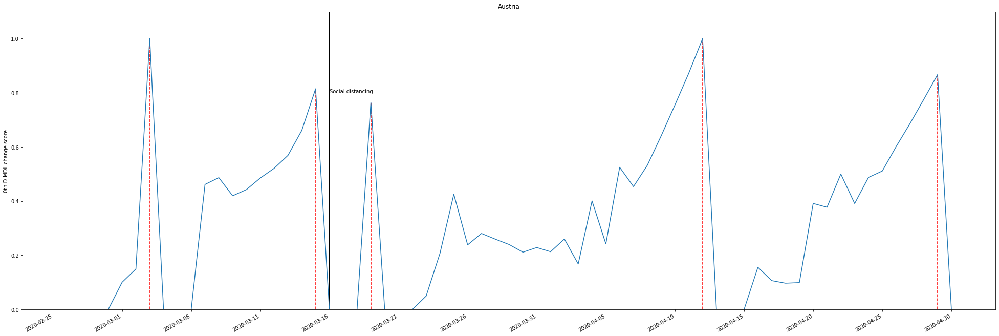

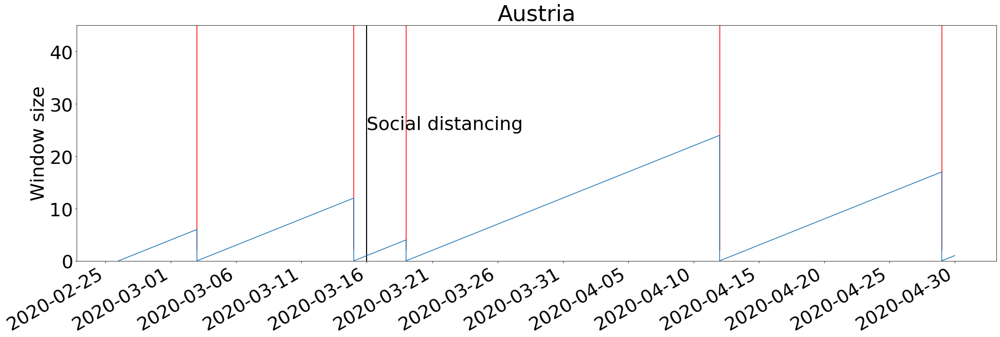

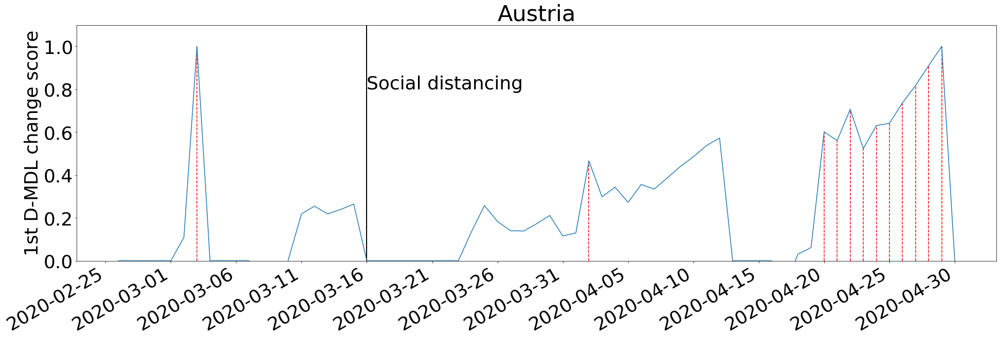

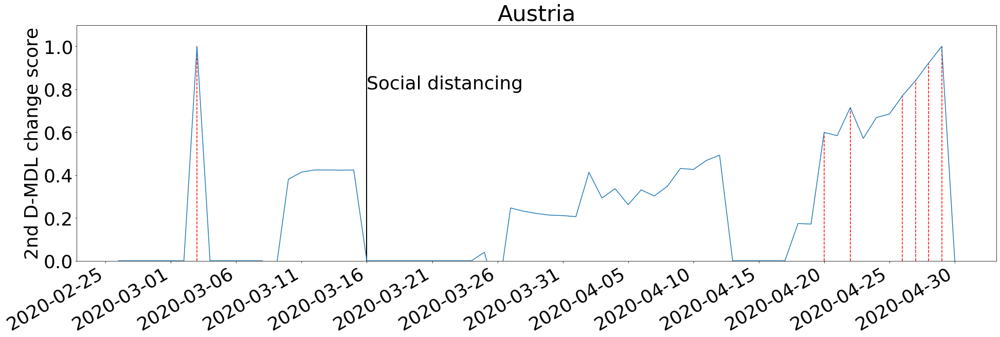

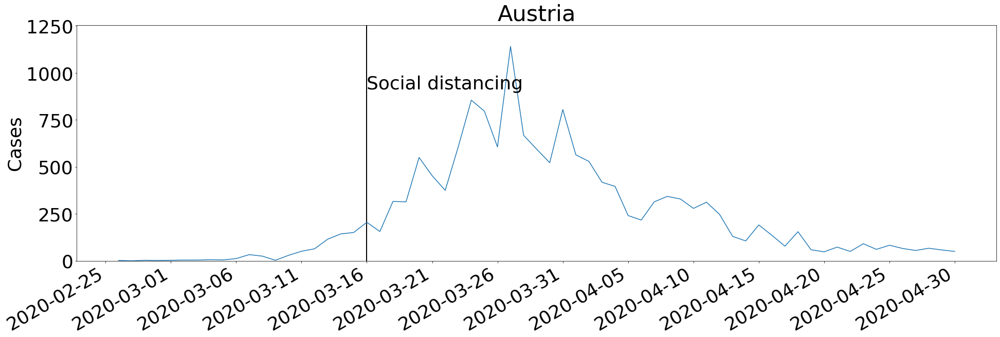

...

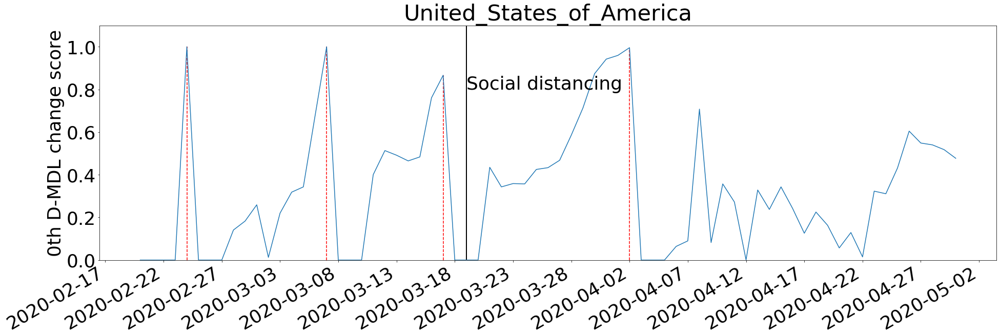

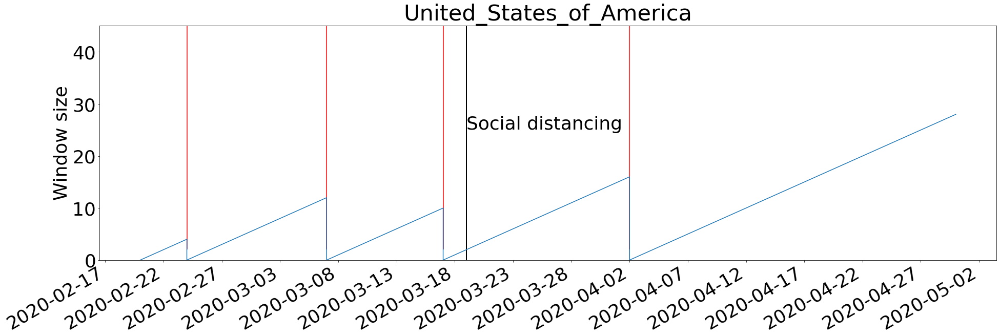

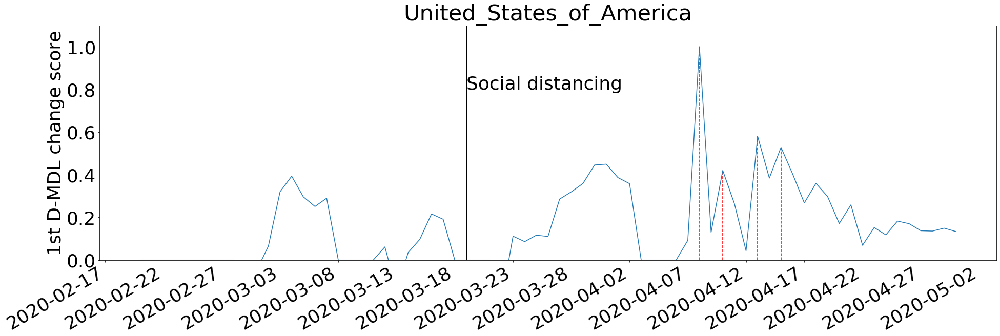

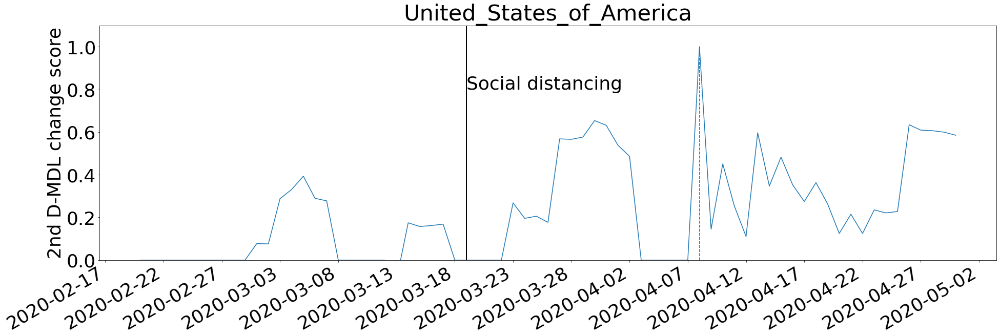

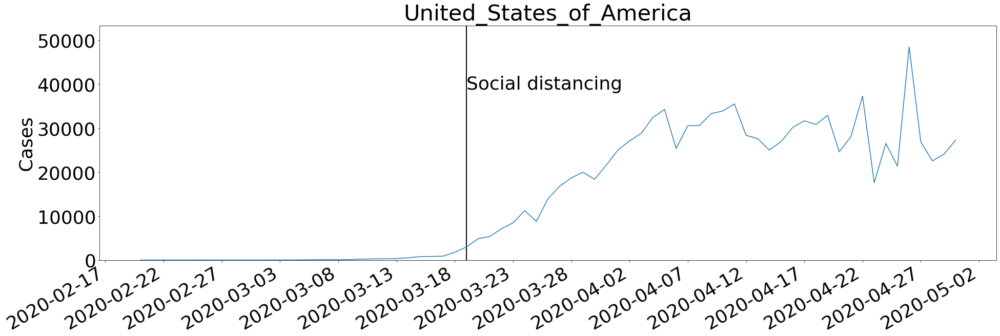

In [18]:
t = np.arange(datetime(2020, 1, 1), datetime(2020, 5, 1), timedelta(days=1)) ## The timeline for online detection
num_change_dict = {} # number of change points before event
num_0th_change_dict = {} # number of 0th change points before event
num_1st_change_dict = {} # number of 1st change points before event
num_2nd_change_dict = {} # number of 2nd change points before event

decrease_dict = {} # the day on which the first decrease change point raised by 0th for countries with event
decrease_no_event_dict = {} # the day on which the first decrease change raised by 0th for countries without event

days_between_zero_earliest = [] # days between the 0th change and the first either 1th or 2nd change within the window
days_between_zero_first = [] # days between the 0th change and the first 1th change within the window
days_between_zero_second = [] # days between the 0th change and the first 2nd change within the window

first_candidate_num = 0 # candicate outbreak allowing for 1st sign detection
first_detected_num = 0 # number of outbreaks whose signs are detected by 1st D-MDL
second_candidate_num = 0 # candicate outbreak allowing for 2nd sign detection
second_detected_num = 0 # number of outbreaks whose signs are detected by 2nd D-MDL
detected_num = 0  # number of outbreaks whose signs are detected by either 1st D-MDL or 2nd D-MDL
candidate_num = 0 # candicate outbreak allowing for both 1st and 2nd sign detection


for country in candidates_country:
    print('country:', country)
    if country in event_dict:
        dates_events = event_dict[country]       
    
    t_candidates = []
    t_num = []
    for date_tmp in t:
        row = df_candidates.loc[(df_candidates['country'] == country) & (df_candidates['date'] == date_tmp)]
        if len(row[category].values) > 0 and (row[category].values[0] > 0):
            t_candidates.append(date_tmp)
            t_num.append(row[category].values[0])  
        else:
            if len(t_num) <= 10 and np.mean(t_num) <= 1:
                t_candidates = []
                t_num = []
            else:
                t_candidates.append(date_tmp)
                t_num.append(0)
            
    case_values = {}
    case_max = 0
    max_date = 0
    for date_tmp in t:
        if date_tmp in t_candidates:
            row = df_candidates.loc[(df_candidates['country'] == country) & (df_candidates['date'] == date_tmp)]
            if len(row[category].values) > 0 and (row[category].values[0] > 0):
                case_values[date_tmp] = row[category].values[0]  
                if case_max < row[category].values[0]:
                    case_max = row[category].values[0]
                    max_date = date_tmp
            else:
                case_values[date_tmp] = 0
     
    
    dict_changes_cases = {}
    dic_windows_cases = {}
    MDL_scores_cases = []
    dates_tmp_cases = []
    windows_cases = []

    dict_first_changes_cases = {}
    dict_first_windows_cases = {}
    MDL_first_scores_cases = []
    dates_tmp_cases_first = []

    dict_second_changes_cases = {}
    dict_second_windows_cases = {}
    MDL_second_scores_cases = []
    dates_tmp_cases_second = []

    window_minimal = 4
    window_size = 0
    num_changes_before_event = 0
    num_0th_changes_before_event = 0
    num_1st_changes_before_event = 0
    num_2nd_changes_before_event = 0
    for date_tmp in t:
        if date_tmp in t_candidates:
            dates_tmp_cases.append(date_tmp)
            dates_tmp_cases_first.append(date_tmp)
            dates_tmp_cases_second.append(date_tmp)
            
            ## 0th D-MDL
            if window_size >= window_minimal:
                t_tmp = np.arange(date_tmp - np.timedelta64(window_size - 1,'D'), date_tmp + np.timedelta64(1,'D'), timedelta(days=1))#.astype(datetime)
                tmp_case_values = []
                for d in t_tmp:
                    if d in case_values:
                        tmp_case_values.append(case_values[d])
                    else:
                        tmp_case_values.append(0)
                
                MDL_max, cut_point = MDL_gaussian_0th(tmp_case_values)
                MDL_scores_cases.append(MDL_max) 

                windows_cases.append(window_size)
                threshold_tmp = threshod_MDL(delta, dimension, window_size)
                print('date:{0}, window size:{1}, threshold:{2}, MDL score:{3}'.format(date_tmp, window_size, threshold_tmp, MDL_max))

                #### first order ####
                if window_size >= 5:
                    MDL_max_first, t_cut_first = MDL_gaussian_1th(tmp_case_values)

                    MDL_first_scores_cases.append(MDL_max_first) 
                    threshold_tmp_first = threshod_F_MDL(delta_first, dimension, window_size)
                    if threshold_tmp_first < 0:
                        threshold_tmp_first = 1e-12
                    print('frist-orde change: date:{0}, threshold:{1}, MDL score:{2}'.format(date_tmp, threshold_tmp_first, MDL_max_first))

                    if MDL_max_first >= threshold_tmp_first:
                        dict_first_changes_cases[dates_tmp_cases[-1]] = MDL_max_first
                        dict_first_windows_cases[dates_tmp_cases[-1]] = t_cut_first 
                        if country in event_dict:
                            if date_tmp < event_dict[country]:
                                num_changes_before_event += 1
                                num_1st_changes_before_event += 1
                                
                        
                else:
                    MDL_first_scores_cases.append(0)
                #### end of first order ####

                #### second order ####
                if window_size >= 6:
                    MDL_max_second, t_cut_second = MDL_gaussian_2nd(tmp_case_values)
                    MDL_second_scores_cases.append(MDL_max_second) 

                    threshold_tmp_second = threshod_S_MDL(delta_second, dimension, window_size)
                    if threshold_tmp_second < 0:
                        threshold_tmp_second = 1e-12
                    print('second-orde change: date:{0}, threshold:{1}, MDL score:{2}'.format(date_tmp, threshold_tmp_second, MDL_max_second))

                    if MDL_max_second >= threshold_tmp_second:
                        dict_second_changes_cases[dates_tmp_cases[-1]] = MDL_max_second
                        dict_second_windows_cases[dates_tmp_cases[-1]] = t_cut_second
                        if country in event_dict:
                            if date_tmp < event_dict[country]:
                                num_changes_before_event += 1
                                num_2nd_changes_before_event += 1
                                
                         
                else:
                    MDL_second_scores_cases.append(0)
                #### end of second order ####

                window_size += 1
                if MDL_max >= threshold_tmp:
                    dict_changes_cases[dates_tmp_cases[-1]] = MDL_max
                    dic_windows_cases[dates_tmp_cases[-1]] = window_size 
                    
                    mean_before = np.mean(tmp_case_values[:cut_point])
                    mean_after = np.mean(tmp_case_values[cut_point:])
                    if mean_before < mean_after:
                        flag_first = False
                        flag_second = False
                    
                        candidate_num += 1
                        if window_size >= 6:
                            first_candidate_num += 1
                            for candidate in t_tmp:
                                if candidate in dict_first_changes_cases:
                                    days_tmp_first = (dates_tmp_cases[-1].astype(datetime) - candidate.astype(datetime)).days
                                    days_between_zero_first.append(days_tmp_first)
                                    days_between_zero_earliest.append(days_tmp_first)
                                    first_detected_num += 1
                                    flag_first = True
                                    break
                            
                        if window_size >= 7:
                            second_candidate_num += 1
                            for candidate in t_tmp:
                                if candidate in dict_second_changes_cases:
                                    days_tmp_second = (dates_tmp_cases[-1].astype(datetime) - candidate.astype(datetime)).days
                                    days_between_zero_second.append(days_tmp_second)
                                    if flag_first and days_tmp_second > days_tmp_first:
                                        days_between_zero_earliest = days_between_zero_earliest[:-1]
                                        days_between_zero_earliest.append(days_tmp_second)
                                    if not flag_first:
                                        days_between_zero_earliest.append(days_tmp_second)
                                    second_detected_num += 1
                                    flag_second = True
                                    break
                                    
                            
                            
                        if flag_first or flag_second:
                            detected_num += 1

                        flag_first = False
                        flag_second = False
                    
                    window_size = 1
                    dates_tmp_cases.append(dates_tmp_cases[-1]) ## for the change point to have to window sizes
                    MDL_scores_cases.append(MDL_max) ## for the change point to have to window sizes
                    windows_cases.append(window_size-1) 

                    ##statistics
                    if country in event_dict:
                        if date_tmp < event_dict[country]:
                            num_changes_before_event += 1
                            num_0th_changes_before_event += 1
                        
                        
                        if country not in decrease_dict:
                            mean_before = np.mean(tmp_case_values[:cut_point])
                            mean_after = np.mean(tmp_case_values[cut_point:])
                            if max_date < date_tmp and date_tmp > event_dict[country] and mean_before > mean_after:
                                decrease_dict[country] = date_tmp
                                #print('data:{}, mean before:{}, mean after:{}'.format(date_tmp, mean_before, mean_after))
                    else:
                        if country not in decrease_no_event_dict:
                            mean_before = np.mean(tmp_case_values[:cut_point])
                            mean_after = np.mean(tmp_case_values[cut_point:])
                            if max_date < date_tmp and mean_before > mean_after:
                                decrease_no_event_dict[country] = date_tmp
                                

                      

            else:
                print('date:{0}, window size:{1}, MDL score:{2}'.format(date_tmp, window_size, 0))
                MDL_scores_cases.append(0)
                windows_cases.append(window_size)
                window_size += 1

                MDL_first_scores_cases.append(0)
                MDL_second_scores_cases.append(0)
    
    if country in event_dict:
        num_change_dict[country] = num_changes_before_event
        num_0th_change_dict[country] = num_0th_changes_before_event
        num_1st_change_dict[country] = num_1st_changes_before_event
        num_2nd_change_dict[country] = num_2nd_changes_before_event
    
    
    ##### zero figure
    max_mdl = 0
    for tmp_mdl in MDL_scores_cases:
        if tmp_mdl > max_mdl and tmp_mdl != float('inf'):
            max_mdl = tmp_mdl
    
    MDL_scores_cases = [x if x != float('inf') else max_mdl for x in MDL_scores_cases]
    MDL_scores_cases[:] /= max_mdl
    
    for key in dict_changes_cases:
        if dict_changes_cases[key] == float('inf'):
            dict_changes_cases[key] = max_mdl
        dict_changes_cases[key] = dict_changes_cases[key] / max_mdl
    
    
    plt.figure(figsize=(28,10))
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases, MDL_scores_cases) # replace X-DATES and Y-VALUES with the variable names
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('0th D-MDL change score')

    change_index = 1
    for key in dict_changes_cases:
        plt.vlines(key, ymin=0, ymax=dict_changes_cases[key], color='r', linestyle='--')
        change_index += 1

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 0.8, 'Social distancing', color='black')

    plt.ylim(0,1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_zero.eps')
    else:
        plt.savefig(output_path+country+'_0_score.eps')
    
    
    ## window figure
    plt.figure(figsize=(28,10))
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases, windows_cases)
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('Window size')


    for key in dic_windows_cases:
        plt.vlines(key, ymin=2, ymax=45.1, color='r', linestyle='-')

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=45.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 25.1, 'Social distancing', color='black')

    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.ylim(0,45.1)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_window.eps')
    else:
        plt.savefig(output_path+country+'_window_size.eps')
    
    
    ##first order figure
    max_first_mdl = 0
    for tmp_mdl in MDL_first_scores_cases:
        if tmp_mdl > max_first_mdl and tmp_mdl != float('inf'):
            max_first_mdl = tmp_mdl
    
    MDL_first_scores_cases = [x if x != float('inf') else max_first_mdl for x in MDL_first_scores_cases]
    
    #MDL_first_max = np.max(MDL_first_scores_cases)
    MDL_first_scores_cases[:] /= max_first_mdl
    
    
    for key in dict_first_changes_cases:
        if dict_first_changes_cases[key] == float('inf'):
            dict_first_changes_cases[key] = max_first_mdl
        dict_first_changes_cases[key] = dict_first_changes_cases[key] / max_first_mdl
        
    
    plt.figure(figsize=(28,10))

    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases_first, MDL_first_scores_cases)
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('1st D-MDL change score')

    change_index = 1
    for key in dict_first_changes_cases:
        plt.vlines(key, ymin=0, ymax=dict_first_changes_cases[key], color='r', linestyle='--')
        change_index += 1

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 0.8, 'Social distancing', color='black')

    plt.ylim(0,1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_first.eps')
    else:
        plt.savefig(output_path+country+'_1_score.eps')
    
    
    ### second order figure
    max_second_mdl = 0
    for tmp_mdl in MDL_second_scores_cases:
        if tmp_mdl > max_second_mdl and tmp_mdl != float('inf'):
            max_second_mdl = tmp_mdl
    
    MDL_second_scores_cases = [x if x != float('inf') else max_second_mdl for x in MDL_second_scores_cases]
    
    #MDL_first_max = np.max(MDL_first_scores_cases)
    MDL_second_scores_cases[:] /= max_second_mdl
    
    for key in dict_second_changes_cases:
        if dict_second_changes_cases[key] == float('inf'):
            dict_second_changes_cases[key] = max_second_mdl
        dict_second_changes_cases[key] = dict_second_changes_cases[key] / max_second_mdl
    
    
    plt.figure(figsize=(28,10))
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases_second, MDL_second_scores_cases)
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('2nd D-MDL change score')

    change_index = 1
    for key in dict_second_changes_cases:
        plt.vlines(key, ymin=0, ymax=dict_second_changes_cases[key], color='r', linestyle='--')
        #plt.text(key, dict_second_changes_cases[key]+0.025, str(change_index), color='black', bbox=box)
        change_index += 1

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 0.8, 'Social distancing', color='black')

    plt.ylim(0,1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_second.eps')
    else:
        plt.savefig(output_path+country+'_2_score.eps')
    
    
    ### cases figure
    plt.figure(figsize=(28,10))
    case_day = []
    days = []
    for key in case_values:
        case_day.append(case_values[key])
        days.append(key)

    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(days, case_day)
    plt.gcf().autofmt_xdate()
    plt.ylabel('Cases')
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
        
    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=np.max(case_day)*1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, np.max(case_day)*0.8, 'Social distancing', color='black')

    plt.ylim(0,np.max(case_day)*1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    plt.savefig(output_path+country+'_case.eps')

## Calculation of statistics

In [19]:
## Number of alarms for non-downward countries
num_change_decrease = []
num_0th_change_decrease = []
num_1st_change_decrease = []
num_2nd_change_decrease = []
num_change_increase = []
num_0th_change_increase = []
num_1st_change_increase = []
num_2nd_change_increase = []
num_0th_days_before_event_decrease = []
num_1st_days_before_event_decrease = []
num_2nd_days_before_event_decrease = []
num_0th_days_before_event_increase = []
num_1st_days_before_event_increase = []
num_2nd_days_before_event_increase = []
num_days_event_to_decrease = []
num_days_increase_to_decrease_event = []
num_days_increase_to_decrease_no_event = []
for key in candidates_country:
    if key in event_dict:
        if key in decrease_dict:
            print('country:{0}, change num:{1}, event-decrease:{2}'.format(key, num_change_dict[key],(decrease_dict[key].astype(datetime) - event_dict[key]).days))
            num_change_decrease.append(num_change_dict[key])
            if key in num_0th_change_dict:
                num_0th_change_decrease.append(num_0th_change_dict[key])
            else:
                num_0th_change_decrease.append(0)
                
            if key in num_1st_change_dict:
                num_1st_change_decrease.append(num_1st_change_dict[key])
            else:
                num_1st_change_decrease.append(0)
                
            if key in num_2nd_change_dict:
                num_2nd_change_decrease.append(num_2nd_change_dict[key])
            else:
                num_2nd_change_decrease.append(0)
            
            num_days_event_to_decrease.append((decrease_dict[key].astype(datetime) - event_dict[key]).days)
        else:
            num_change_increase.append(num_change_dict[key])
            if key in num_0th_change_dict:
                num_0th_change_increase.append(num_0th_change_dict[key])
            else:
                num_0th_change_increase.append(0)
                
            if key in num_1st_change_dict:
                num_1st_change_increase.append(num_1st_change_dict[key])
            else:
                num_1st_change_increase.append(0)
                
            if key in num_2nd_change_dict:
                num_2nd_change_increase.append(num_2nd_change_dict[key])
            else:
                num_2nd_change_increase.append(0)

country:Austria, change num:4, event-decrease:27
country:China, change num:3, event-decrease:25
country:Germany, change num:10, event-decrease:38
country:Iran, change num:4, event-decrease:19
country:Italy, change num:4, event-decrease:23
country:Netherlands, change num:5, event-decrease:43
country:South_Korea, change num:8, event-decrease:18
country:Spain, change num:4, event-decrease:35
country:Switzerland, change num:1, event-decrease:38
country:Turkey, change num:0, event-decrease:34


In [20]:
## Number of alarms for non-downward countries
for key in event_dict:
    if key not in decrease_dict:
        print('country:{0}, change num:{1}'.format(key, num_change_dict[key]))

country:Belarus, change num:8
country:Belgium, change num:7
country:Brazil, change num:4
country:Canada, change num:7
country:Chile, change num:12
country:France, change num:6
country:India, change num:2
country:Indonesia, change num:5
country:Ireland, change num:2
country:Israel, change num:2
country:Japan, change num:13
country:Mexico, change num:0
country:Pakistan, change num:5
country:Peru, change num:1
country:Poland, change num:4
country:Portugal, change num:6
country:Qatar, change num:6
country:Romania, change num:3
country:Russia, change num:9
country:Saudi_Arabia, change num:5
country:Singapore, change num:18
country:Sweden, change num:6
country:Ukraine, change num:0
country:United_Arab_Emirates, change num:9
country:United_Kingdom, change num:12
country:United_States_of_America, change num:3


In [21]:
## total number of alarms before the event for downward countries
np.mean(num_change_decrease), np.std(num_change_decrease)

(4.3, 2.7946377224964243)

In [22]:
## total number of alarms before the event for non-downward countries
np.mean(num_change_increase), np.std(num_change_increase)

(5.961538461538462, 4.219740870924598)

In [23]:
#number of 0th alarms before the event for downward countries and non-downward ones, respectively
np.mean(num_0th_change_decrease), np.std(num_0th_change_decrease), np.mean(num_0th_change_increase), np.std(num_0th_change_increase)

(2.0, 1.5491933384829668, 1.8461538461538463, 1.4058205294228512)

In [24]:
#number of 1th alarms before the event for downward countries and non-downward ones, respectively
np.mean(num_1st_change_decrease), np.std(num_1st_change_decrease),np.mean(num_1st_change_increase), np.std(num_1st_change_increase)

(1.7, 1.4177446878757824, 3.076923076923077, 2.335727146259843)

In [25]:
#number of 2nd alarms before the event for downward countries and non-downward ones, respectively
np.mean(num_2nd_change_decrease), np.std(num_2nd_change_decrease),np.mean(num_2nd_change_increase), np.std(num_2nd_change_increase)

(0.6, 0.66332495807108, 1.0384615384615385, 1.5312330182611065)

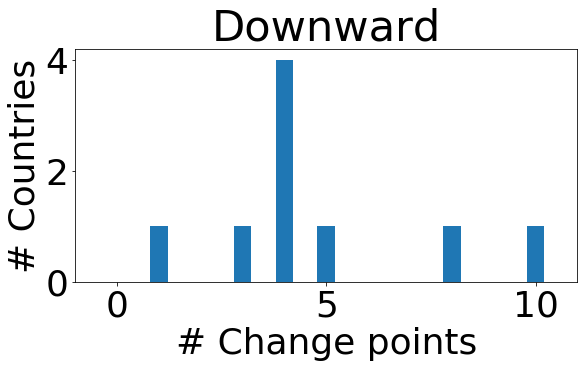

In [26]:
plt.figure(figsize=(9,6))
bins = np.arange(0.5, 11.5, 1) # fixed bin size
plt.xlim([min(num_change_decrease)-1, max(num_change_decrease)+1])
plt.hist(num_change_decrease, bins=bins, rwidth=0.422)
plt.ylabel('# Countries')
plt.xlabel('# Change points')
plt.title('Downward')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'decrease_change_before_event.eps')

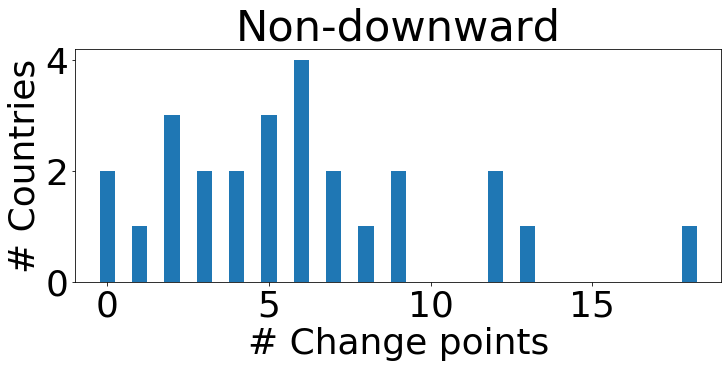

In [27]:
plt.figure(figsize=(11,6))
plt.xlim([min(num_change_increase)-1, max(num_change_increase)+1])
bins = np.arange(-0.5, 19.5, 1)
plt.hist(num_change_increase, bins=bins, rwidth=0.47)
plt.ylabel('# Countries')
plt.xlabel('# Change points')
plt.title('Non-downward')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'increase_change_before_event.eps')

In [28]:
## total number of outbreaks and number of outbreaks whose signs were detected by either the 1st or the 2nd D-MDL
candidate_num, detected_num

(106, 68)

In [29]:
##Total number of outbreaks that allowed for the 1st D-MDL sign detection and Number of outbreaks whose signs were detected by the 1st D-MDL
first_candidate_num, first_detected_num 

(88, 65)

In [30]:
##Total number of outbreaks that allowed for the 2nd D-MDL sign detection and Number of outbreaks whose signs were detected by the 2nd D-MDL
second_candidate_num, second_detected_num 

(81, 27)

In [31]:
## Number of days before an outbreak for the first sign of either the 1st or the 2nd D-MDL
np.mean(days_between_zero_earliest), np.std(days_between_zero_earliest), np.min(days_between_zero_earliest), np.max(days_between_zero_earliest)

(6.25, 6.0375662217778565, 0, 22)

In [32]:
## Number of days before an outbreak for the first sign of the 1st
np.mean(days_between_zero_first), np.std(days_between_zero_first), np.min(days_between_zero_first), np.max(days_between_zero_first)

(6.3538461538461535, 5.9106963516109285, 0, 22)

In [33]:
## Number of days before an outbreak for the first sign of the 2nd
np.mean(days_between_zero_second), np.std(days_between_zero_second), np.min(days_between_zero_second), np.max(days_between_zero_second)

(5.555555555555555, 6.499762578759852, 0, 22)

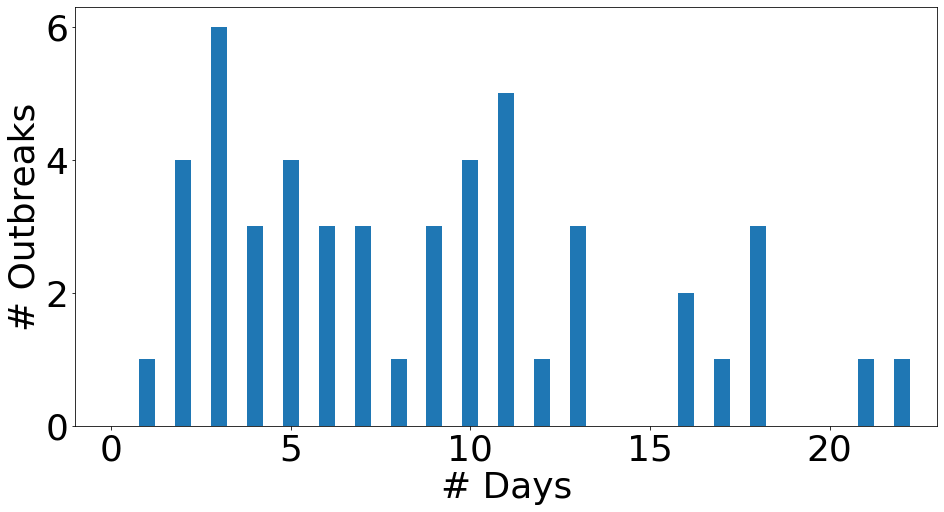

In [34]:
plt.figure(figsize=(14,8))
bins = np.arange(0.5, 23.5, 1) # fixed bin size
plt.xlim([min(days_between_zero_earliest)-1, max(days_between_zero_earliest)+1])
plt.hist(days_between_zero_earliest, bins=bins, rwidth=0.446)
plt.ylabel('# Outbreaks')
plt.xlabel('# Days')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_between_zero_earliest.eps')

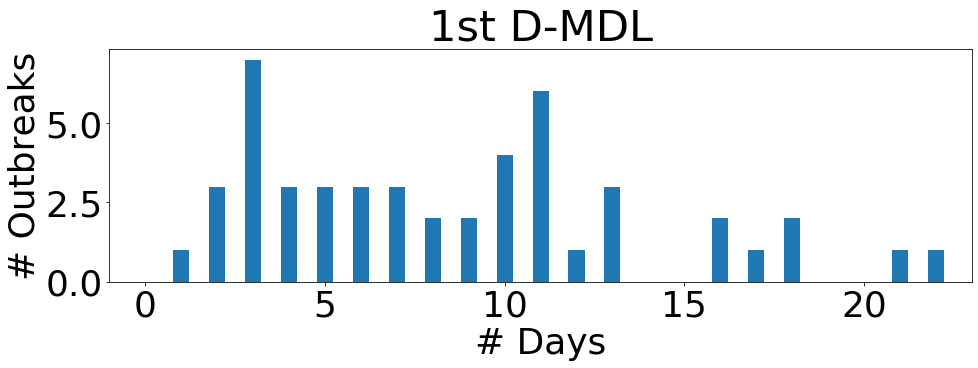

In [35]:
plt.figure(figsize=(14,6))
bins = np.arange(0.5, 23.5, 1) # fixed bin size
plt.xlim([min(days_between_zero_first)-1, max(days_between_zero_first)+1])
plt.hist(days_between_zero_first, bins=bins, rwidth=0.446)
plt.ylabel('# Outbreaks')
plt.xlabel('# Days')
plt.title('1st D-MDL')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_between_zero_first.eps')

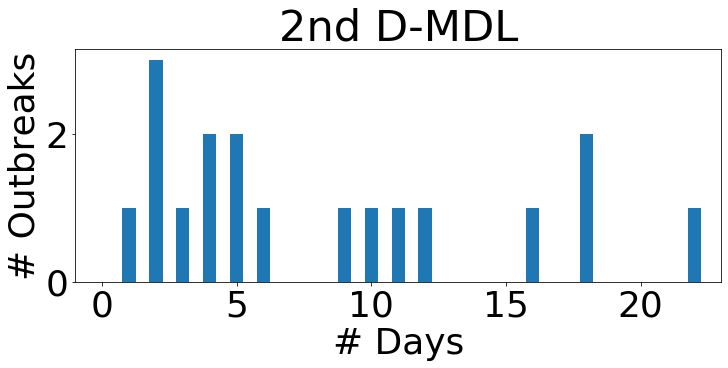

In [36]:
plt.figure(figsize=(11,6))
bins = np.arange(0.5, 23.5, 1) # fixed bin size
plt.xlim([min(days_between_zero_second)-1, max(days_between_zero_second)+1])
plt.hist(days_between_zero_second, bins=bins, rwidth=0.495)
plt.ylabel('# Outbreaks')
plt.xlabel('# Days')
plt.title('2nd D-MDL')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_between_zero_second.eps')

In [37]:
## Number of days from event’s date to the first downward change’s (0th D-MDL alarm)date
np.mean(num_days_event_to_decrease), np.std(num_days_event_to_decrease), np.max(num_days_event_to_decrease)

(30.0, 8.282511696339462, 43)

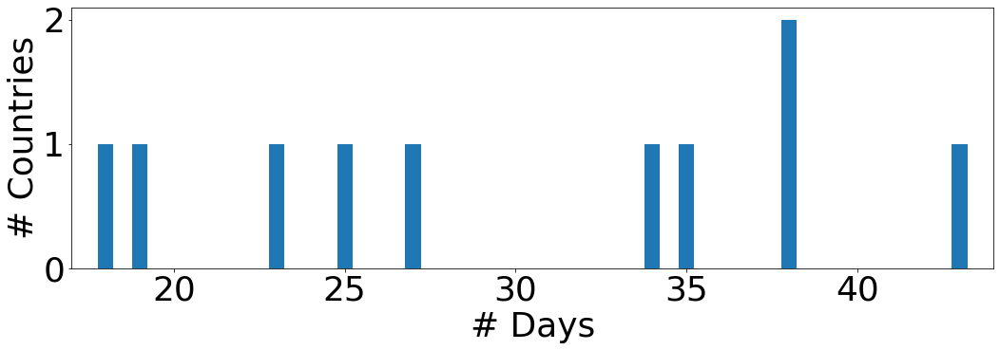

In [38]:
plt.figure(figsize=(15.5,6))
bins = np.arange(2.5, 44.5, 1) # fixed bin size
plt.xlim([min(num_days_event_to_decrease)-1, max(num_days_event_to_decrease)+1])
#plt.xticks(range(6))
plt.hist(num_days_event_to_decrease, bins=bins, rwidth=0.455)
plt.ylabel('# Countries')
plt.xlabel('# Days')
#plt.title('Days from event to ')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_event_to_decrease.eps')